# Dog Breed Classification Project

**Column Description**

You are provided with a training set and a test set of images of dogs. Each image has a filename that is its unique id. The dataset comprises 120 breeds of dogs. The goal of the competition is to create a classifier capable of determining a dog's breed from a photo. The list of breeds is as follows:

* affenpinscher
* afghan_hound
* african_hunting_dog
* airedale
* american_staffordshire_terrier
* appenzeller
* australian_terrier
* basenji
* basset
* beagle
* bedlington_terrier
* bernese_mountain_dog
* black-and-tan_coonhound
* blenheim_spaniel
* bloodhound
* bluetick
* vborder_collie
* border_terrier
* borzoi
* boston_bull
* bouvier_des_flandres
* boxer
* brabancon_griffon
* briard
* brittany_spaniel
* bull_mastiff
* cairn
* cardigan
* chesapeake_bay_retriever
* chihuahua
* chow
* clumber
* cocker_spaniel
* collie
* curly-coated_retriever
* dandie_dinmont
* dhole
* dingo
* doberman
* english_foxhound
* english_setter
* english_springer
* entlebucher
* eskimo_dog
* flat-coated_retriever
* french_bulldog
* german_shepherd
* german_short-haired_pointer
* giant_schnauzer
* golden_retriever
* gordon_setter
* great_dane
* great_pyrenees
* greater_swiss_mountain_dog
* groenendael
* ibizan_hound
* irish_setter
* irish_terrier
* irish_water_spaniel
* irish_wolfhound
* italian_greyhound
* japanese_spaniel
* keeshond
* kelpie
* kerry_blue_terrier
* komondor
* kuvasz
* labrador_retriever
* lakeland_terrier
* leonberg
* lhasa
* malamute
* malinois
* maltese_dog
* mexican_hairless
* miniature_pinscher
* miniature_poodle
* miniature_schnauzer
* newfoundland
* norfolk_terrier
* norwegian_elkhound
* norwich_terrier
* old_english_sheepdog
* otterhound
* papillon
* pekinese
* pembroke
* pomeranian
* pug
* redbone
* rhodesian_ridgeback
* rottweiler
* saint_bernard
* saluki
* samoyed
* schipperke
* scotch_terrier
* scottish_deerhound
* sealyham_terrier
* shetland_sheepdog
* shih-tzu
* siberian_husky
* silky_terrier
* soft-coated_wheaten_terrier
* staffordshire_bullterrier
* standard_poodle
* standard_schnauzer
* sussex_spaniel
* tibetan_mastiff
* tibetan_terrier
* toy_poodle
* toy_terrier
* vizsla
* walker_hound
* weimaraner
* welsh_springer_spaniel
* west_highland_white_terrier
* whippet
* wire-haired_fox_terrier
* yorkshire_terrier

## Getting our Data Ready

In [ ]:
# Importing Necessary Modules

import tensorflow as tf
import tensorflow_hub as hub
import tf_keras
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
# Importing our Data

labels_csv=pd.read_csv("drive/MyDrive/Dog Vision/labels.csv")
print(labels_csv.describe())
labels_csv.head()

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     fff43b07992508bc822f33d8ffd902ae  scottish_deerhound
freq                                   1                 126


,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


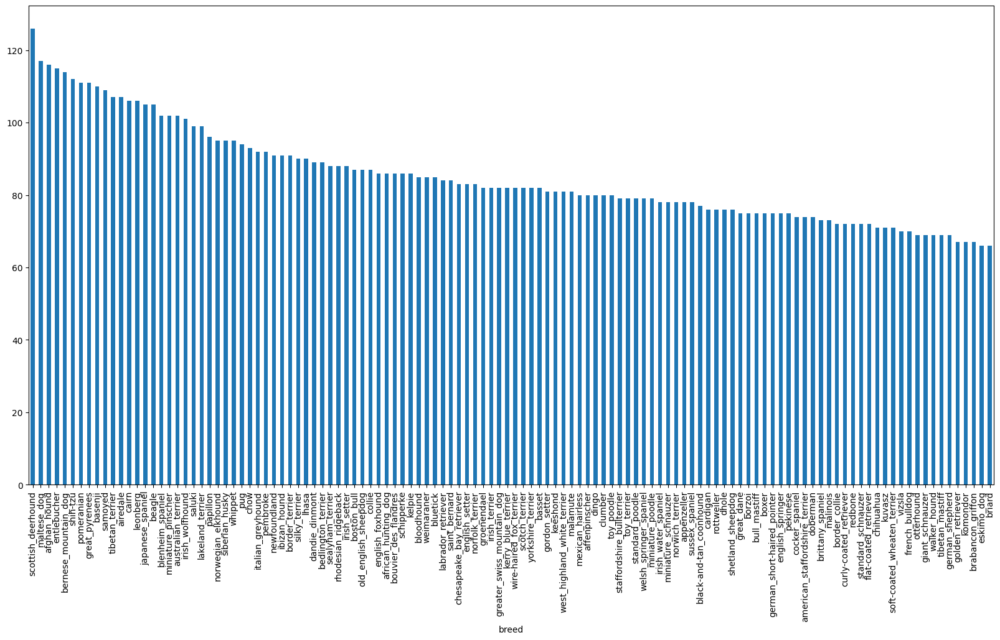

In [ ]:
# Plotting Various Dog Breeds

labels_csv["breed"].value_counts().plot(kind="bar" , figsize=(20,10));

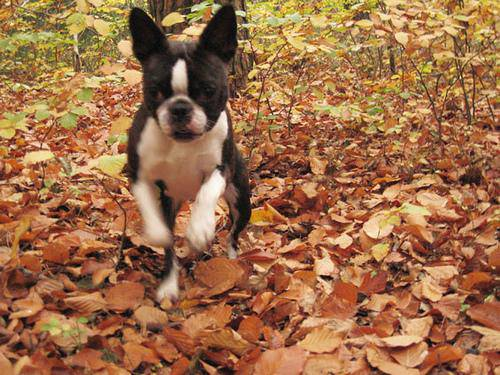

In [ ]:
# Viewing Images

from IPython.display import Image
Image("drive/MyDrive/Dog Vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg")

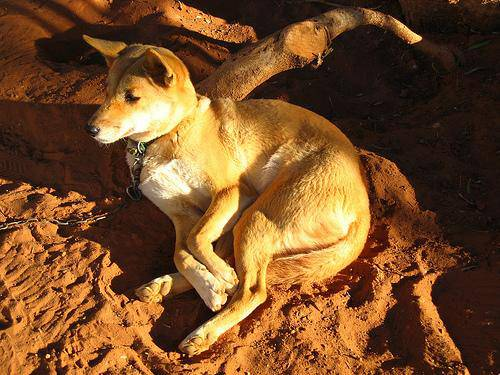

In [ ]:
Image("drive/MyDrive/Dog Vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg")

In [ ]:
# Images in Filename

imafile=["drive/MyDrive/Dog Vision/train/"+ fname + ".jpg" for fname in labels_csv.id]
imafile[:5]

['drive/MyDrive/Dog Vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/MyDrive/Dog Vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/MyDrive/Dog Vision/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/MyDrive/Dog Vision/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/MyDrive/Dog Vision/train/0021f9ceb3235effd7fcde7f7538ed62.jpg']

In [ ]:
#  Creating Breeds Array

labels=np.array(labels_csv.breed)
labels

array(['boston_bull', 'dingo', 'pekinese', ..., 'airedale',
       'miniature_pinscher', 'chesapeake_bay_retriever'], dtype=object)

In [ ]:
# Accessing Unique Brees

uni_bre=np.unique(labels)
uni_bre

array(['affenpinscher', 'afghan_hound', 'african_hunting_dog', 'airedale',
       'american_staffordshire_terrier', 'appenzeller',
       'australian_terrier', 'basenji', 'basset', 'beagle',
       'bedlington_terrier', 'bernese_mountain_dog',
       'black-and-tan_coonhound', 'blenheim_spaniel', 'bloodhound',
       'bluetick', 'border_collie', 'border_terrier', 'borzoi',
       'boston_bull', 'bouvier_des_flandres', 'boxer',
       'brabancon_griffon', 'briard', 'brittany_spaniel', 'bull_mastiff',
       'cairn', 'cardigan', 'chesapeake_bay_retriever', 'chihuahua',
       'chow', 'clumber', 'cocker_spaniel', 'collie',
       'curly-coated_retriever', 'dandie_dinmont', 'dhole', 'dingo',
       'doberman', 'english_foxhound', 'english_setter',
       'english_springer', 'entlebucher', 'eskimo_dog',
       'flat-coated_retriever', 'french_bulldog', 'german_shepherd',
       'german_short-haired_pointer', 'giant_schnauzer',
       'golden_retriever', 'gordon_setter', 'great_dane',
      

In [ ]:
bool_labels=[label == uni_bre for label in labels]
bool_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [ ]:
# Turn into X and y

X=imafile
y=bool_labels

In [ ]:
# Creating a Slider

NUM_IMAGES = 1000 #@param{type:"slider" , min:1000 , max:10222 , step:100}

In [ ]:
# Import Train Test Split Module
np.random.seed(30)
from sklearn.model_selection import train_test_split
# Split our Data into Training Set and Test Set
X_train , X_val , y_train , y_val = train_test_split(X[:NUM_IMAGES] , y[:NUM_IMAGES] , test_size=0.2 , random_state=30)

len(X_train) , len(X_val) , len(y_train) , len(y_val)

(800, 200, 800, 200)

In [ ]:
X_train[:2] , y_train[:2]

(['drive/MyDrive/Dog Vision/train/13b5f36cb39cb5123958c6e4fbfd5399.jpg',
  'drive/MyDrive/Dog Vision/train/0822709f6f6ea0be1928f52b8eecbc2f.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False,  True, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, Fal

## Turn into Tensors

array([[[171, 115,  78],
        [170, 114,  77],
        [168, 114,  76],
        ...,
        [190, 167,  91],
        [190, 168,  93],
        [188, 169,  93]],

       [[172, 116,  79],
        [171, 115,  78],
        [169, 115,  77],
        ...,
        [195, 171,  97],
        [195, 173,  98],
        [193, 174,  98]],

       [[174, 118,  81],
        [173, 117,  80],
        [171, 117,  79],
        ...,
        [201, 175, 101],
        [198, 176, 103],
        [196, 176, 103]],

       ...,

       [[ 66,  46,  13],
        [ 71,  51,  16],
        [ 79,  59,  26],
        ...,
        [ 75,  33,  17],
        [ 85,  48,  29],
        [ 84,  49,  27]],

       [[ 72,  49,  15],
        [ 69,  47,  10],
        [ 80,  57,  23],
        ...,
        [ 73,  31,  15],
        [ 81,  46,  26],
        [ 82,  50,  29]],

       [[ 72,  50,  13],
        [ 69,  47,  10],
        [ 80,  58,  21],
        ...,
        [ 73,  31,  15],
        [ 81,  46,  26],
        [ 82,  50,  29]]], dtype=uint8)
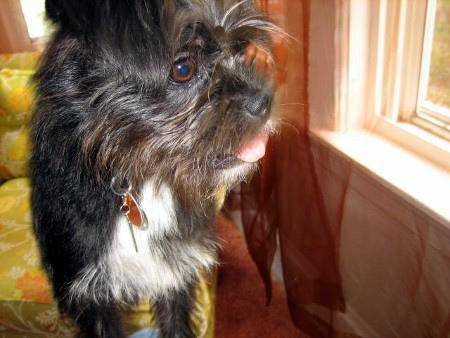

In [ ]:
# Convert Image into Numpy Array

from matplotlib.pyplot import imread
image=imread(imafile[30])
image.shape
image

In [ ]:
# Coverting into Tensors

tf.constant(image)

<tf.Tensor: shape=(338, 450, 3), dtype=uint8, numpy=
array([[[171, 115,  78],
        [170, 114,  77],
        [168, 114,  76],
        ...,
        [190, 167,  91],
        [190, 168,  93],
        [188, 169,  93]],

       [[172, 116,  79],
        [171, 115,  78],
        [169, 115,  77],
        ...,
        [195, 171,  97],
        [195, 173,  98],
        [193, 174,  98]],

       [[174, 118,  81],
        [173, 117,  80],
        [171, 117,  79],
        ...,
        [201, 175, 101],
        [198, 176, 103],
        [196, 176, 103]],

       ...,

       [[ 66,  46,  13],
        [ 71,  51,  16],
        [ 79,  59,  26],
        ...,
        [ 75,  33,  17],
        [ 85,  48,  29],
        [ 84,  49,  27]],

       [[ 72,  49,  15],
        [ 69,  47,  10],
        [ 80,  57,  23],
        ...,
        [ 73,  31,  15],
        [ 81,  46,  26],
        [ 82,  50,  29]],

       [[ 72,  50,  13],
        [ 69,  47,  10],
        [ 80,  58,  21],
        ...,
        [ 73,  31,  1

In [ ]:
# Preproccessing our Image

IMG_SIZE=224
def preprocess(image_path):
  image=tf.io.read_file(image_path)
  image=tf.image.decode_jpeg(image , channels=3)
  image=tf.image.convert_image_dtype(image , tf.float32)
  image = tf.image.resize(image, size=[IMG_SIZE,IMG_SIZE])
  return image

## Turn Data into Batches

In [ ]:
# Turning into Batches

def batch(image_path,label):
  image=preprocess(image_path)
  return image,label

In [ ]:
BATCH_SIZE=32
def batch_process(X, y=None, valid_data=False, test_data=False, batch_size=BATCH_SIZE):
    if test_data:
        data = tf.data.Dataset.from_tensor_slices(tf.constant(X))
        data_batch = data.map(preprocess).batch(batch_size)
        return data_batch

    elif valid_data:
        data = tf.data.Dataset.from_tensor_slices((tf.constant(X), tf.constant(y)))
        data_batch = data.map(batch).batch(batch_size)
        return data_batch

    else:
        data = tf.data.Dataset.from_tensor_slices((tf.constant(X), tf.constant(y)))
        data = data.shuffle(buffer_size=len(X))
        data_batch = data.map(batch).batch(batch_size)
        return data_batch

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Creaing Training and Validating Batches

train_data=batch_process(X_train,y_train)
valid_data=batch_process(X_val,y_val,valid_data=True)

In [ ]:
train_data.element_spec , valid_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

In [ ]:
# Visulising our Batch Data

def batch_plot(images,labels):
  plt.figure(figsize=(15,15))
  for i in range(32):
    ax=plt.subplot(8,4,i+1)
    plt.imshow(images[i])
    plt.title(uni_bre[labels[i].argmax()])
    plt.axis("off")

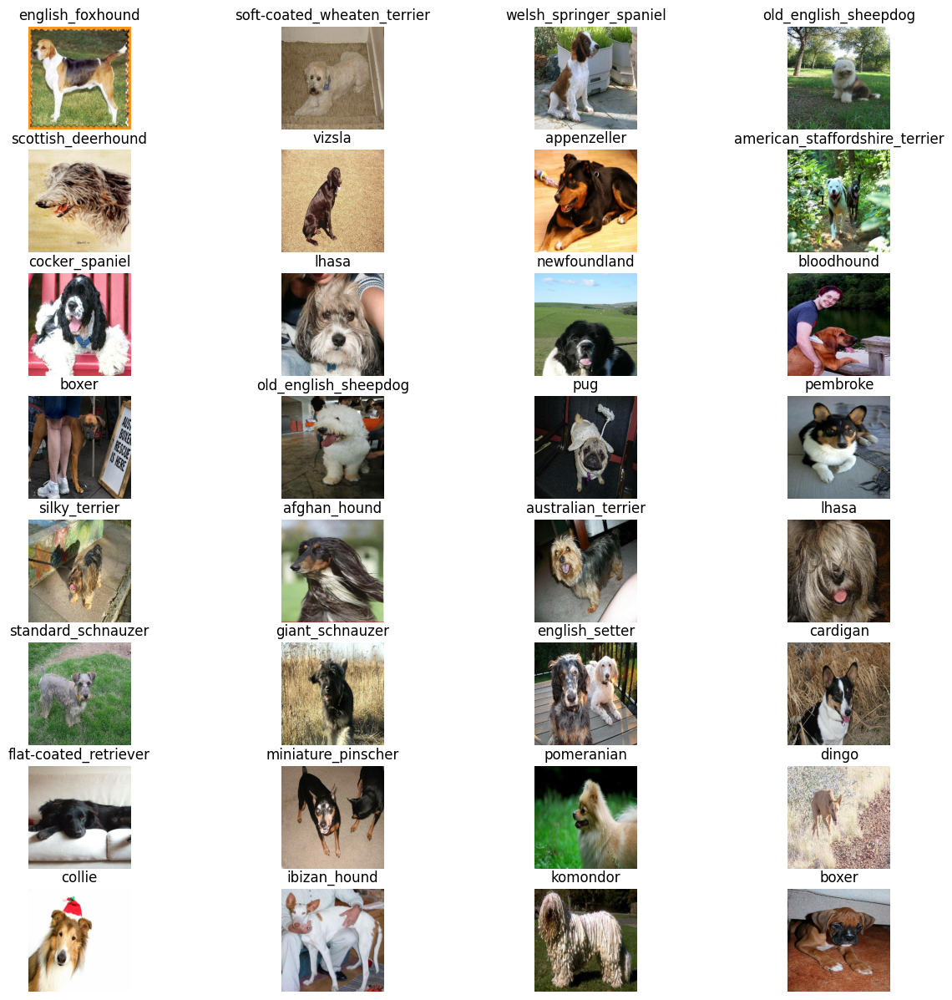

In [ ]:
# Viewing Training Batch

train_images , train_labels = next(train_data.as_numpy_iterator())
batch_plot(train_images , train_labels)

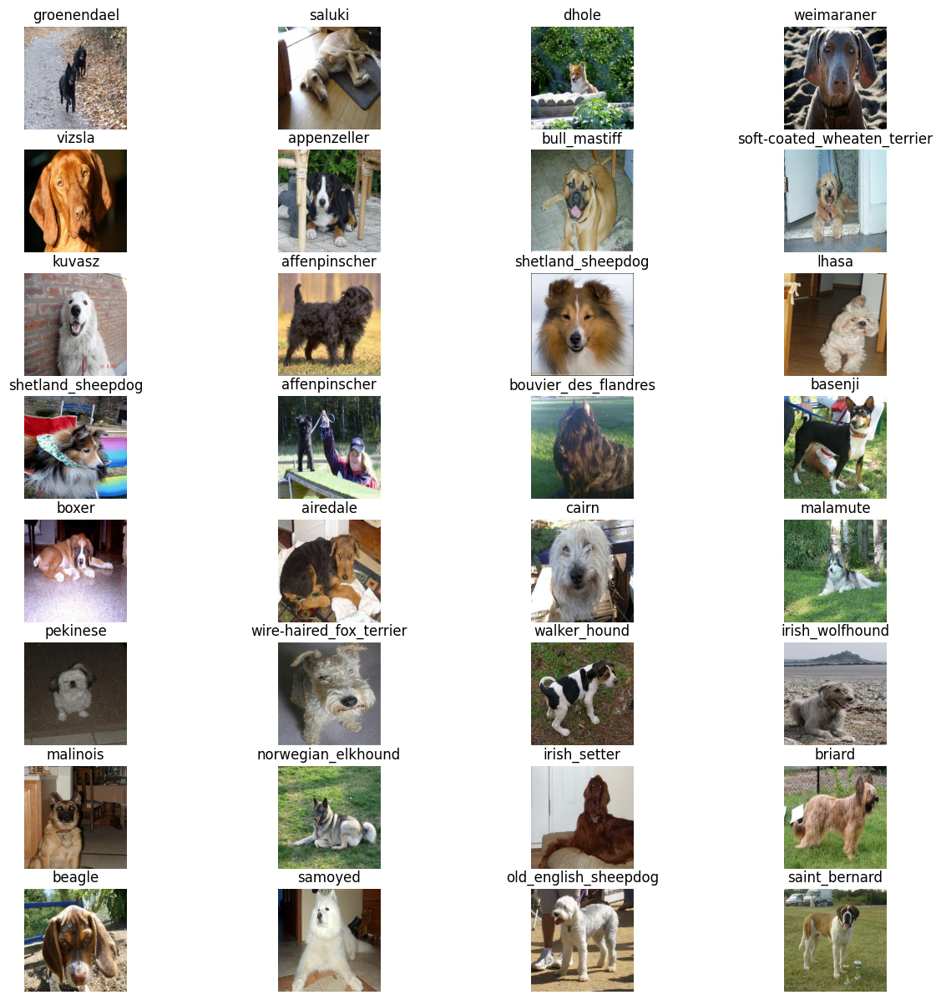

In [ ]:
# Viewing Validation Batch

valid_images , valid_labels = next(valid_data.as_numpy_iterator())
batch_plot(valid_images , valid_labels)

## Pick up a Model

In [ ]:
# Picking a Model

INPUT_SHAPE = [None,IMG_SIZE,IMG_SIZE,3]
OUTPUT_SHAPE = len(uni_bre)
MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4"

In [ ]:
# Build a Model

def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
  model = tf_keras.Sequential([hub.KerasLayer(MODEL_URL, trainable=True) , tf_keras.layers.Dense(output_shape, activation='softmax')])
  model.compile(loss=tf_keras.losses.CategoricalCrossentropy(),optimizer=tf_keras.optimizers.Adam(),metrics=["accuracy"])
  model.build(INPUT_SHAPE)
  return model

In [ ]:
model=create_model()
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1001)              5432713   
                                                                 
 dense (Dense)               (None, 120)               120240    
                                                                 
Total params: 5552953 (21.18 MB)
Trainable params: 5508697 (21.01 MB)
Non-trainable params: 44256 (172.88 KB)
_________________________________________________________________


## Creating CallBacks

In [ ]:
# Importing TensorBoard

%load_ext tensorboard

In [ ]:
# Creating Callback for TensorBoards

import os , datetime
def TensorBoard_CallBacks():
  logdir=os.path.join("drive/MyDrive/Dog Vision/logs" , datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return tf_keras.callbacks.TensorBoard(logdir)

In [ ]:
# Creating Callback for Early Stopping
earlystopping=tf_keras.callbacks.EarlyStopping(monitor="val_accuracy" , patience=3)

## Fitting our Data

In [ ]:
NUM_EPOCHS = 100 # @param {"type":"slider","min":10,"max":100,"step":10}

In [ ]:
# Building a Training Model

def train_model():
  model=create_model()
  tensorboard=TensorBoard_CallBacks()
  model.fit(x=train_data , validation_data=valid_data , epochs=NUM_EPOCHS , validation_freq=1 , callbacks=[tensorboard , earlystopping])
  return model

In [ ]:
model=train_model()

Epoch 1/100
25/25 [==============================] - 198s 7s/step - loss: 4.9732 - accuracy: 0.0700 - val_loss: 27.8459 - val_accuracy: 0.0200
Epoch 2/100
25/25 [==============================] - 6s 233ms/step - loss: 2.8036 - accuracy: 0.3812 - val_loss: 11.2426 - val_accuracy: 0.0350
Epoch 3/100
25/25 [==============================] - 5s 213ms/step - loss: 1.8837 - accuracy: 0.5838 - val_loss: 11.3401 - val_accuracy: 0.0550
Epoch 4/100
25/25 [==============================] - 5s 207ms/step - loss: 1.2718 - accuracy: 0.7025 - val_loss: 10.9456 - val_accuracy: 0.0400
Epoch 5/100
25/25 [==============================] - 6s 234ms/step - loss: 1.0752 - accuracy: 0.7437 - val_loss: 14.3903 - val_accuracy: 0.0300
Epoch 6/100
25/25 [==============================] - 6s 242ms/step - loss: 0.8207 - accuracy: 0.8037 - val_loss: 8.6322 - val_accuracy: 0.0500


In [ ]:
%tensorboard --logdir "drive/MyDrive/Dog Vision/logs"

Reusing TensorBoard on port 6006 (pid 4002), started 0:02:17 ago. (Use '!kill 4002' to kill it.)

<IPython.core.display.Javascript object>

## Make Predictions on Validation Data

In [ ]:
# Making Predictions

pre=model.predict(valid_data , verbose=3)
pre

array([[7.8100878e-05, 4.8183027e-04, 2.2957356e-05, ..., 4.3868992e-04,
        1.1646365e-02, 4.0826799e-06],
       [2.2859192e-06, 1.2849201e-04, 3.2869082e-08, ..., 5.3210100e-05,
        9.7684109e-01, 1.8883840e-06],
       [1.7455326e-05, 1.3835230e-03, 5.2750849e-05, ..., 2.0991767e-02,
        3.8784802e-02, 1.6178815e-07],
       ...,
       [2.5370017e-11, 2.9162925e-07, 8.1595911e-11, ..., 8.9978817e-04,
        1.0199773e-04, 1.1968718e-10],
       [6.3739208e-07, 2.4317217e-04, 1.5171881e-05, ..., 8.5743988e-05,
        4.2048510e-02, 1.0676300e-04],
       [1.0567208e-09, 1.1973777e-06, 3.9805886e-10, ..., 5.8413276e-05,
        1.9041369e-04, 7.2896672e-10]], dtype=float32)

In [ ]:
# Viewing Predictions

def predictions(index):
  print(pre[index])
  print(f"Max Value : {np.max(pre[index])}")
  print(f"Sum Value : {np.sum(pre[index])}")
  print(f"Max Index : {np.argmax(pre[index])}")
  print(f"Predicted Label : {uni_bre[np.argmax(pre[index])]}")

In [ ]:
predictions(0)

[7.81008785e-05 4.81830270e-04 2.29573561e-05 4.14746937e-05
 1.86232537e-01 2.51280144e-04 2.69619704e-06 1.15048618e-03
 1.17271029e-05 4.81149691e-05 4.29132022e-03 1.99197311e-04
 3.84266750e-04 6.91597001e-04 1.98807847e-02 1.40594915e-04
 1.54348032e-03 4.01032681e-04 6.65070329e-05 2.04395829e-03
 7.20368931e-03 3.13324235e-05 4.23792936e-02 3.22108413e-03
 6.09814379e-06 1.58201605e-01 5.81353379e-04 4.73071967e-04
 2.12181083e-04 9.21069841e-06 3.13404691e-03 1.36546225e-06
 2.22281393e-04 1.25565697e-02 2.45954981e-03 4.85271332e-04
 1.40870534e-05 1.58080105e-02 8.73151075e-05 1.42657000e-03
 2.11255028e-05 6.39846257e-04 3.98137308e-05 1.73373474e-03
 7.12869441e-05 3.92101938e-03 3.41845116e-05 1.26488987e-04
 1.09311915e-03 7.04936974e-04 8.45246599e-04 1.68945844e-05
 2.05407277e-01 3.35652335e-03 1.71493288e-04 6.89841167e-04
 3.71333997e-04 8.46901850e-04 1.04542427e-01 5.65408700e-05
 2.85215501e-04 4.78674984e-03 6.84261977e-05 6.82948041e-04
 7.98839610e-03 1.150462

In [ ]:
predictions(30)

[3.21259819e-09 3.68837476e-08 4.56858787e-11 2.49592684e-08
 3.99424732e-02 1.13908499e-07 1.71579240e-09 5.81484016e-07
 6.57881083e-09 3.29833783e-09 7.89406186e-05 3.39357931e-10
 2.02696437e-09 4.03716753e-04 1.34631171e-06 6.12885529e-08
 1.17263276e-07 2.11864815e-09 2.68391295e-06 7.01381850e-08
 1.77480160e-05 8.20212804e-08 6.48628600e-07 1.25364622e-07
 1.86527487e-07 1.09358843e-05 7.90051558e-07 3.14475308e-08
 5.20020638e-10 1.97639405e-10 5.77285526e-08 2.18731717e-11
 1.12101339e-09 4.57978895e-04 2.11602554e-07 7.78597496e-06
 6.71960576e-09 4.71834909e-08 1.65419358e-08 3.96747600e-05
 7.42195372e-09 1.42616656e-07 2.67380090e-10 1.63988763e-04
 1.89522339e-07 7.59118109e-07 6.44631848e-11 4.32979235e-08
 1.64491468e-07 3.49070632e-07 4.66546413e-10 3.72073305e-06
 1.62966363e-02 9.61450041e-07 2.69036682e-09 6.92323665e-05
 1.12154751e-10 2.69752206e-07 4.08646841e-08 9.24118098e-08
 2.80040702e-08 3.82168291e-05 1.90957605e-09 3.97004385e-08
 5.52264146e-06 1.701494

In [ ]:
predictions(199)

[1.0567208e-09 1.1973777e-06 3.9805886e-10 4.3981272e-09 1.3850667e-03
 7.7298568e-09 4.5599062e-09 5.0707484e-08 1.3676367e-09 3.9084864e-09
 2.1069577e-06 3.7988421e-09 4.9994884e-09 6.6948545e-05 2.1135670e-06
 6.8161641e-09 1.1788086e-06 2.2617606e-09 1.5625159e-07 1.0602550e-07
 9.1196262e-07 6.0201700e-08 9.6475475e-08 4.5237158e-08 2.2235092e-08
 1.4302547e-05 7.5788881e-07 5.6582183e-09 2.8799988e-08 3.6132131e-10
 5.3102696e-08 8.3101720e-12 9.5097863e-10 9.1152964e-05 2.8120135e-07
 3.5841654e-06 1.3685945e-09 2.2801142e-08 1.7640945e-08 4.7953381e-06
 2.3717034e-08 2.1780503e-08 9.8208002e-09 2.2143665e-07 1.2964489e-07
 3.4231768e-06 1.1584710e-09 2.4945761e-08 1.4660739e-07 1.0031232e-05
 8.1048029e-10 4.8076993e-07 9.9724895e-01 2.5371668e-07 8.3479303e-09
 1.0612165e-06 3.5294139e-09 4.3828776e-09 3.2272811e-07 2.3891017e-08
 6.4310910e-08 1.6083917e-05 4.9308198e-09 1.0551907e-08 1.7026521e-07
 1.7797279e-07 7.4257099e-05 1.9674303e-08 8.1804530e-10 1.9393698e-10
 3.007

In [ ]:
# Transform Prediction into Labels

def get_label(predicted):
  return uni_bre[np.argmax(predicted)]

In [ ]:
pred_label=[]
for i in pre:
  pred_label.append(get_label(i))

In [ ]:
len(pred_label)

200

In [ ]:
# Unbatching our Validation Data

def unbatchify(data):
  ima=[]
  lab=[]
  for image , label in data.unbatch().as_numpy_iterator():
    ima.append(image)
    lab.append(label)
  return ima,lab

In [ ]:
val_img , val_lab = unbatchify(valid_data)

In [ ]:
val_labels=[]
for i in val_lab:
  val_labels.append(get_label(i))

In [ ]:
val_labels[30] , pred_label[30]

('old_english_sheepdog', 'wire-haired_fox_terrier')

## Visualising our Model

In [ ]:
# Visualising our Predicted Probsbilities

def plot_pre(predict , labels , images , n=30):
  pred_lab , true_label , image = predict[n] , labels[n] , images[n]
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])
  if pred_lab == true_label:
    color="green"
  else:
    color="red"
  plt.title("{} {:2.0f}% {}".format(pred_lab , np.max(pre[n]*100) , true_label),color=color)

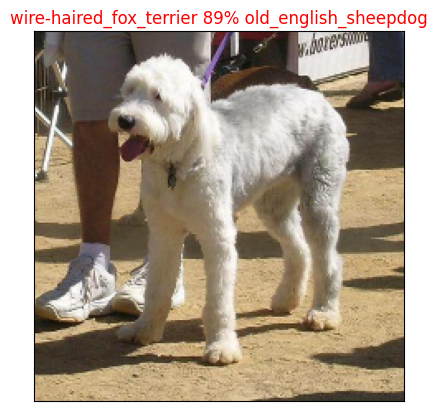

In [ ]:
plot_pre(predict=pred_label , labels=val_labels , images=val_img)

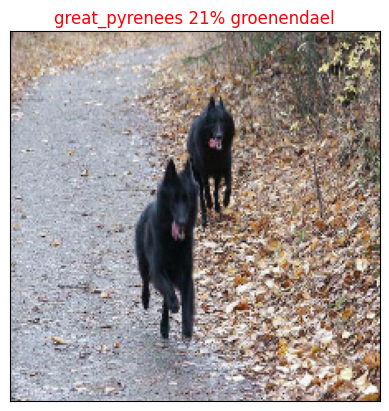

In [ ]:
plot_pre(predict=pred_label , labels=val_labels , images=val_img , n=0)

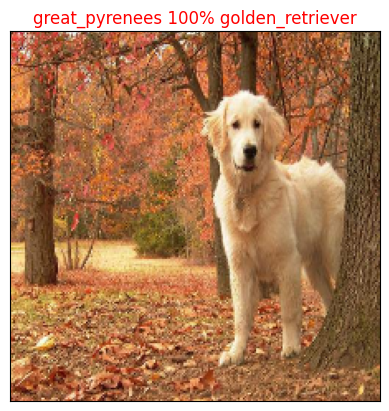

In [ ]:
plot_pre(predict=pred_label , labels=val_labels , images=val_img , n=199)

In [ ]:
# Sorting our Prediction

pre_sort = pre
pre_sort.sort()
pre_sort[0]

array([8.61130331e-07, 1.36546225e-06, 2.69619704e-06, 4.08267988e-06,
       4.94861570e-06, 6.09814379e-06, 9.21069841e-06, 1.17271029e-05,
       1.40870534e-05, 1.68945844e-05, 2.07601515e-05, 2.11255028e-05,
       2.29573561e-05, 2.63345992e-05, 2.82211004e-05, 2.85451533e-05,
       3.13324235e-05, 3.41845116e-05, 3.90039895e-05, 3.98137308e-05,
       4.14746937e-05, 4.81149691e-05, 5.65408700e-05, 6.65070329e-05,
       6.84261977e-05, 7.12869441e-05, 7.81008785e-05, 8.21013309e-05,
       8.73151075e-05, 9.10674644e-05, 1.15046205e-04, 1.15276125e-04,
       1.23664431e-04, 1.26488987e-04, 1.34173184e-04, 1.40594915e-04,
       1.56694718e-04, 1.71493288e-04, 1.80234245e-04, 1.80371280e-04,
       1.80459640e-04, 1.97793270e-04, 1.99197311e-04, 2.04441152e-04,
       2.12181083e-04, 2.22281393e-04, 2.41991147e-04, 2.50284735e-04,
       2.51280144e-04, 2.62236397e-04, 2.80358567e-04, 2.85215501e-04,
       2.95477163e-04, 3.27006477e-04, 3.34041921e-04, 3.34201090e-04,
      

while(True):
  if pred_label == val_labels:
    print(pred_label , val_labels)
    break

In [ ]:
# Visualising our Predicted Probabilities Confidence

def plot_pre_con(predict , labels , n=30):
  pred_label , true_label = predict[n] , labels[n]
  top_10_indexes = pre[n].argsort()[-10:][::-1]
  top_10_values = pre[n][top_10_indexes]
  top_10_pred_label = uni_bre[top_10_indexes]
  top_plot = plt.bar(np.arange(len(top_10_pred_label)) , top_10_values ,color="grey")
  plt.xticks(np.arange(len(top_10_pred_label)) , labels=top_10_pred_label , rotation="vertical")
  if np.isin(true_label , top_10_pred_label):
    top_plot[np.argmax(true_label == top_10_pred_label)].set_color("green")

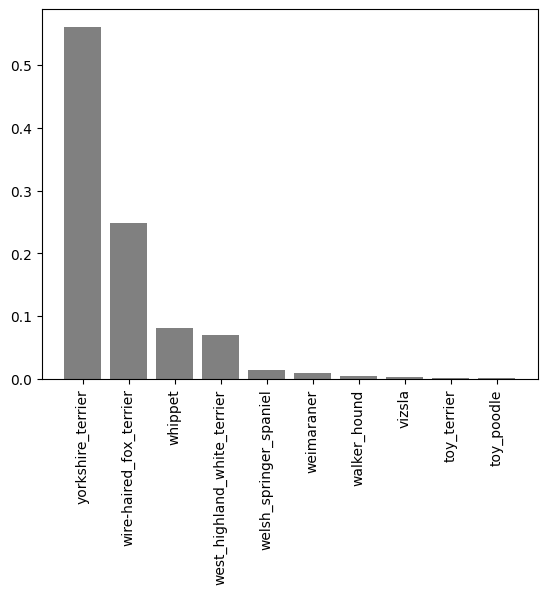

In [ ]:
plot_pre_con(pred_label , val_labels , n=5)

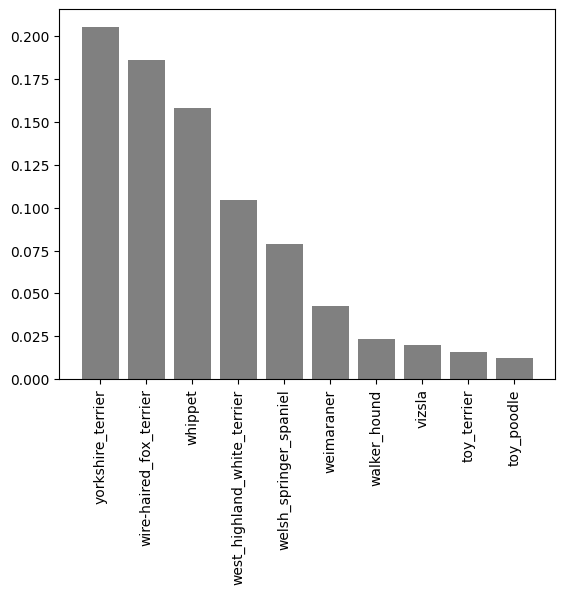

In [ ]:
plot_pre_con(pred_label , val_labels , n=0)

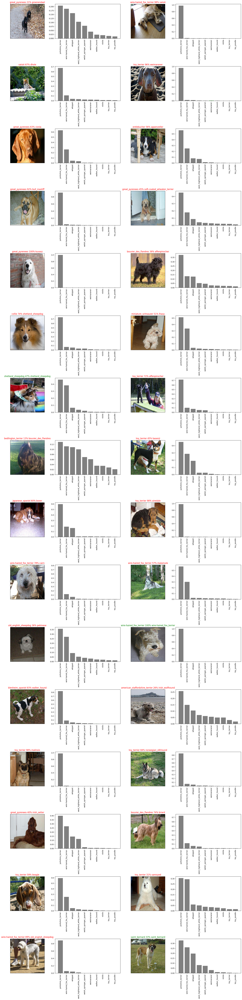

In [ ]:
# Visualising our Predicted Probabilities and its Confidence

i_multiplier=0
rows=16
cols=2
num_images=rows*cols
plt.figure(figsize=(10*cols,5*rows))
for i in range(num_images):
  plt.subplot(rows,2*cols,2*i+1)
  plot_pre(predict=pred_label , labels=val_labels , images=val_img , n=i+i_multiplier)
  plt.subplot(rows,2*cols,2*i+2)
  plot_pre_con(pred_label , val_labels , n=i+i_multiplier)
  plt.tight_layout(h_pad=1.0);
plt.show()

## Evaluating our Model

In [ ]:
# Evalauting

model.evaluate(valid_data)

7/7 [==============================] - 1s 135ms/step - loss: 8.6322 - accuracy: 0.0500


[8.632177352905273, 0.05000000074505806]

## Training our Model on Full Dataset

In [ ]:
# Create Batches for Full Dataset

full_data = batch_process(X,y)
full_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [ ]:
# Creating our Full Model

full_model = create_model()
full_model

In [ ]:
# Creating Callbacks for Full Dataset

full_model_tensorboard = TensorBoard_CallBacks()
full_model_early_stopping = tf_keras.callbacks.EarlyStopping(monitor="accuracy",patience=3)

In [ ]:
# Fitting our Full Dataset to the Model

full_model.fit(x=full_data , epochs=NUM_EPOCHS , callbacks=[full_model_tensorboard , full_model_early_stopping])

Epoch 1/100
320/320 [==============================] - 1798s 6s/step - loss: 3.2832 - accuracy: 0.2474
Epoch 2/100
320/320 [==============================] - 62s 192ms/step - loss: 2.2682 - accuracy: 0.4150
Epoch 3/100
320/320 [==============================] - 62s 193ms/step - loss: 1.9012 - accuracy: 0.4955
Epoch 4/100
320/320 [==============================] - 61s 191ms/step - loss: 1.6368 - accuracy: 0.5649
Epoch 5/100
320/320 [==============================] - 61s 191ms/step - loss: 1.4850 - accuracy: 0.6099
Epoch 6/100
320/320 [==============================] - 62s 192ms/step - loss: 1.3451 - accuracy: 0.6463
Epoch 7/100
320/320 [==============================] - 61s 192ms/step - loss: 1.2106 - accuracy: 0.6848
Epoch 8/100
320/320 [==============================] - 61s 191ms/step - loss: 1.1319 - accuracy: 0.7092
Epoch 9/100
320/320 [==============================] - 62s 194ms/step - loss: 1.0953 - accuracy: 0.7242
Epoch 10/100
320/320 [==============================] - 62s 193ms

## Saving our Model

In [ ]:
# Saving

def save_model(model , suffix=None):
  modeldir=os.path.join("drive/MyDrive/Dog Vision/model" , datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  model_path=modeldir+"-"+suffix+".h5"
  model.save(model_path)
  return model_path

In [ ]:
save_model(model,suffix="1000-images-mobilenetv2-Adam")

/usr/local/lib/python3.10/dist-packages/tf_keras/src/engine/training.py:3098: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native TF-Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


'drive/MyDrive/Dog Vision/model/20240820-06521724136740-1000-images-mobilenetv2-Adam.h5'

In [ ]:
save_model(full_model,suffix="full-images-mobilenetv2-Adam")

/usr/local/lib/python3.10/dist-packages/tf_keras/src/engine/training.py:3098: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native TF-Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


'drive/MyDrive/Dog Vision/model/20240820-06541724136861-full-images-mobilenetv2-Adam.h5'

## Load our Model

In [ ]:
# Loading

def load_model(model_path):
  model=tf_keras.models.load_model(model_path , custom_objects={"KerasLayer" : hub.KerasLayer})
  return model

In [ ]:
load_1000_model=load_model("drive/MyDrive/Dog Vision/model/20240820-06521724136740-1000-images-mobilenetv2-Adam.h5")
load_1000_model.evaluate(valid_data) , model.evaluate(valid_data)

NameError: name 'valid_data' is not defined

In [ ]:
load_full_model=load_model("drive/MyDrive/Dog Vision/model/20240820-06541724136861-full-images-mobilenetv2-Adam.h5")

## Making Prediction on Test Dataset

In [ ]:
# Importing Test Files

import os
test_path="drive/MyDrive/Dog Vision/test/"
test_filesname=[test_path + i for i in os.listdir(test_path)]
test_filesname[:10]

['drive/MyDrive/Dog Vision/test/e4cffb02169d9b46810d50c6b9eae28d.jpg',
 'drive/MyDrive/Dog Vision/test/e6da14858db7781843db6af91551f627.jpg',
 'drive/MyDrive/Dog Vision/test/e3dd8fc9162f726122ca4cc783114c81.jpg',
 'drive/MyDrive/Dog Vision/test/e7b4b0e7d7d76f8dbd64920f34443b25.jpg',
 'drive/MyDrive/Dog Vision/test/dd7bf84df93991b7c15ec739c82acc04.jpg',
 'drive/MyDrive/Dog Vision/test/e0806e5049519130d459dd7bd640a092.jpg',
 'drive/MyDrive/Dog Vision/test/e57fded38af2f081403feefb324ed3a9.jpg',
 'drive/MyDrive/Dog Vision/test/e774fbfeb4b712ca042f93edea3835af.jpg',
 'drive/MyDrive/Dog Vision/test/e43f6e621469f438f351d31d889b839f.jpg',
 'drive/MyDrive/Dog Vision/test/e6926a5046cd957245918c33985bcd62.jpg']

In [ ]:
test_data=batch_process(test_filesname,test_data=True)
test_data

<_BatchDataset element_spec=TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None)>

In [ ]:
# Making Predictions

test_predictions=load_full_model.predict(test_data,verbose=1)

KeyboardInterrupt: 

In [ ]:
test_predictions[:10]

## Saving our Predictions

In [ ]:
# Saving

np.savetxt("drive/MyDrive/Dog Vision/predictions.csv" , test_predictions , delimiter=",")

In [ ]:
# Loading our Predictions

load_test_predictions=np.loadtxt("drive/MyDrive/Dog Vision/predictions.csv" , delimiter=",")

In [ ]:
load_test_predictions[:10]

array([[4.05355464e-13, 1.91481206e-12, 1.52529031e-13, ...,
        1.67370640e-16, 4.96511190e-15, 1.55677922e-15],
       [1.81880512e-03, 5.96712576e-03, 1.92158532e-05, ...,
        1.03681314e-05, 4.44564139e-05, 6.09254130e-06],
       [1.71115573e-06, 4.73768068e-07, 3.07581359e-07, ...,
        1.08528075e-05, 1.75327557e-08, 3.78471555e-07],
       ...,
       [3.21703517e-08, 4.06121615e-07, 3.64810511e-08, ...,
        2.68343740e-07, 1.54212323e-08, 2.26414727e-06],
       [4.77941992e-12, 9.27994227e-12, 5.91519628e-12, ...,
        6.04863715e-08, 4.28062430e-09, 4.03957645e-10],
       [2.92958102e-05, 5.08269579e-07, 1.77730435e-05, ...,
        3.19766084e-04, 2.19453996e-05, 3.20452200e-05]])

## Creating the Required Format File for Submission in Kaggle

In [ ]:
# Creating a Empty Dataframe
pred_df=pd.DataFrame(columns=["id"]+list(uni_bre))

# Add Id values to Dataframe
test_ids=[os.path.splitext(path)[0] for path in os.listdir(test_path)]
pred_df["id"]=test_ids
pred_df[list(uni_bre)]=test_predictions
pred_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e4cffb02169d9b46810d50c6b9eae28d,4.053555e-13,1.914812e-12,1.525290e-13,3.104038e-11,1.866094e-15,5.602236e-14,2.685022e-13,6.199345e-15,2.590112e-13,...,5.145453e-10,2.937243e-17,4.671316e-11,1.241442e-16,2.314811e-16,1.816000e-10,3.468695e-14,1.673706e-16,4.965112e-15,1.556779e-15
1,e6da14858db7781843db6af91551f627,1.818805e-03,5.967126e-03,1.921585e-05,1.099017e-05,1.193575e-05,8.579555e-04,6.119772e-06,1.163400e-04,7.896359e-06,...,5.195848e-06,5.046674e-07,1.001915e-05,3.154454e-06,1.266601e-05,8.543971e-06,3.020578e-04,1.036813e-05,4.445641e-05,6.092541e-06
2,e3dd8fc9162f726122ca4cc783114c81,1.711156e-06,4.737681e-07,3.075814e-07,9.279485e-09,4.771018e-06,7.969784e-06,1.364388e-07,1.569957e-08,1.483719e-10,...,4.794368e-09,4.262338e-07,1.410830e-07,6.562154e-09,3.424790e-05,1.809000e-07,2.838579e-07,1.085281e-05,1.753276e-08,3.784716e-07
3,e7b4b0e7d7d76f8dbd64920f34443b25,1.278473e-09,1.153404e-11,2.888535e-11,2.287920e-11,1.593493e-06,1.060470e-08,2.759464e-10,2.254007e-09,4.965050e-07,...,4.792773e-10,6.906946e-08,1.083751e-02,5.202938e-08,9.826601e-01,1.060659e-10,2.459098e-10,2.106591e-09,2.109454e-09,8.342336e-09
4,dd7bf84df93991b7c15ec739c82acc04,9.998671e-01,3.389622e-12,3.386354e-11,5.638482e-15,1.537730e-12,5.392508e-13,1.938358e-11,3.359842e-11,3.224213e-12,...,2.808280e-08,3.267579e-13,4.200597e-12,2.077349e-12,2.028231e-14,2.979990e-14,6.681107e-10,2.700840e-12,5.246797e-12,1.668577e-07


In [ ]:
## Saving Required Format File as CSV File

pred_df.to_csv("drive/MyDrive/Dog Vision/final_predictions.csv" ,index=False)

## Making Predictions on Own Images

In [ ]:
# Making Predictions

path_custom="drive/MyDrive/Dog Vision/Dog Images/"
custom_path=[path_custom +  fname for fname in os.listdir(path_custom)]
custom_path
custom_data=batch_process(custom_path , test_data=True)
custom_preds=load_full_model.predict(custom_data)
custom_labels=[get_label(custom_preds[i]) for i in range(3)]
custom_labels

1/1 [==============================] - 0s 54ms/step


['basset', 'bedlington_terrier', 'pug']